In [68]:
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
import mplleaflet
import shapely
import seaborn as sns
import numpy as np


%matplotlib inline


pd.set_option("max_columns", None)

## Part 1: Exploratory Data Analysis

In [69]:
print "Crime data for the City of Chicago, Illinois for the year of 2016"
crime=pd.read_csv("/Users/mkrupoff/Desktop/metrics_proj_2/Crimes_-_2001_to_present-2.csv")


Crime data for the City of Chicago, Illinois for the year of 2016


In [70]:
print crime.shape
crime.head()

(266955, 22)


,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,10508593,HZ250410,05/03/2016 09:00:00 PM,042XX W MADISON ST,1811,NARCOTICS,POSS: CANNABIS 30GMS OR LESS,SIDEWALK,True,False,1115,11,28,26,18,1148220.0,1899677.0,2016,05/10/2016 03:56:50 PM,41.880658,-87.731212,"(41.880658176, -87.731212135)"
1,10508594,HZ250385,05/03/2016 09:35:00 PM,065XX S KEDVALE AVE,0810,THEFT,OVER $500,APARTMENT,False,True,833,8,13,65,06,1149830.0,1860872.0,2016,05/10/2016 03:56:50 PM,41.774141,-87.726307,"(41.77414081, -87.726307093)"
2,10508595,HZ250362,05/03/2016 02:45:00 PM,045XX S DAMEN AVE,0560,ASSAULT,SIMPLE,STREET,False,True,924,9,12,61,08A,1163662.0,1874660.0,2016,05/10/2016 03:56:50 PM,41.811698,-87.675214,"(41.811697721, -87.675214316)"
3,10508597,HZ250202,05/03/2016 06:42:00 PM,063XX S CLAREMONT AVE,0486,BATTERY,DOMESTIC BATTERY SIMPLE,SIDEWALK,False,True,825,8,15,66,08B,1161829.0,1862607.0,2016,05/10/2016 03:56:50 PM,41.778661,-87.682273,"(41.778661058, -87.68227253)"
4,10508598,HZ250298,05/03/2016 03:00:00 PM,070XX S INDIANA AVE,0320,ROBBERY,STRONGARM - NO WEAPON,SIDEWALK,False,False,322,3,6,69,03,1178808.0,1858478.0,2016,05/10/2016 03:56:50 PM,41.766961,-87.620152,"(41.766961034, -87.620152116)"


Types of Crime in this Dataset
THEFT                                61421
BATTERY                              50267
CRIMINAL DAMAGE                      31007
ASSAULT                              18724
DECEPTIVE PRACTICE                   17833
OTHER OFFENSE                        17136
BURGLARY                             14274
NARCOTICS                            12900
ROBBERY                              11957
MOTOR VEHICLE THEFT                  11317
CRIMINAL TRESPASS                     6306
WEAPONS VIOLATION                     3438
OFFENSE INVOLVING CHILDREN            2248
PUBLIC PEACE VIOLATION                1604
CRIM SEXUAL ASSAULT                   1472
INTERFERENCE WITH PUBLIC OFFICER       934
SEX OFFENSE                            929
PROSTITUTION                           800
HOMICIDE                               781
ARSON                                  518
LIQUOR LAW VIOLATION                   226
KIDNAPPING                             201
GAMBLING               

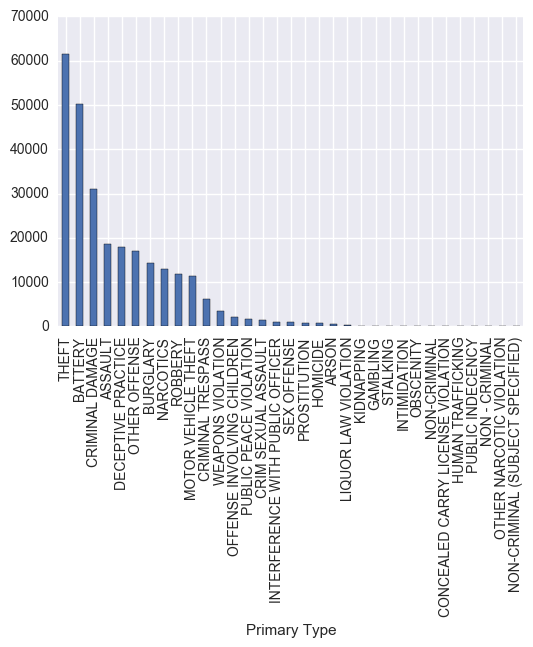

In [71]:
print "Types of Crime in this Dataset"
print crime['Primary Type'].value_counts()
crime.groupby('Primary Type').size().sort_values(ascending=False).plot(kind='bar')

In [73]:
print "Types of theft"
print thefts['Description'].value_counts()

print "-------"
print "-------"



print "Types of Battery"
print battery['Description'].value_counts()

print "--------"
print "--------"

print "Types of Assault"
print assault['Description'].value_counts()

print "--------"
print "--------"


print "Types of Narcotics"
narcotics['Description'].value_counts()

Types of theft
$500 AND UNDER                 24222
OVER $500                      15154
FROM BUILDING                   9957
RETAIL THEFT                    8982
POCKET-PICKING                  1981
PURSE-SNATCHING                  654
ATTEMPT THEFT                    415
DELIVERY CONTAINER THEFT          32
FROM COIN-OP MACHINE/DEVICE       23
THEFT RETAIL                       1
Name: Description, dtype: int64
-------
-------
Types of Battery
DOMESTIC BATTERY SIMPLE                                        24729
SIMPLE                                                         16037
AGGRAVATED: HANDGUN                                             2691
AGGRAVATED: OTHER DANG WEAPON                                   1884
AGGRAVATED DOMESTIC BATTERY: OTHER DANG WEAPON                  1088
AGGRAVATED:KNIFE/CUTTING INSTR                                   852
AGGRAVATED DOMESTIC BATTERY: KNIFE/CUTTING INST                  728
PRO EMP HANDS NO/MIN INJURY                                      67

POSS: CANNABIS 30GMS OR LESS                           4042
POSS: HEROIN(WHITE)                                    2136
MANU/DELIVER: HEROIN (WHITE)                           1088
POSS: CRACK                                             970
FOUND SUSPECT NARCOTICS                                 809
POSS: CANNABIS MORE THAN 30GMS                          509
MANU/DELIVER:CRACK                                      459
MANU/DEL:CANNABIS 10GM OR LESS                          459
POSS: COCAINE                                           438
MANU/DEL:CANNABIS OVER 10 GMS                           323
SOLICIT NARCOTICS ON PUBLICWAY                          211
POSS: SYNTHETIC DRUGS                                   203
POSSESSION OF DRUG EQUIPMENT                            168
POSS: PCP                                               161
POSS: BARBITUATES                                       111
FORFEIT PROPERTY                                         98
ATTEMPT POSSESSION NARCOTICS            

In [74]:
print "Dropping Missing Values"


print "-----------------------"
print "Number of Missing values"
print crime["Latitude"].isnull().sum()
crime = crime.dropna()


print "--"
print "New Number of Missing values"
print crime["Latitude"].isnull().sum()
#Drop the missing values

Dropping Missing Values
-----------------------
Number of Missing values
15863
--
New Number of Missing values
0


## Part 2 Geospatial Analysis

This section will use geospatial analysis to predict crime rates in Chicago. I will use different techniques, such as Kernel density estimation, simple chloropleth maps, as well as spatially weighted chloropleth maps. Finally, I will use spatial clustering analysis to determine areas where crime is most clustered.

First, I will use geopandas to import a shape file of Chicago census tracts.
{'init': u'epsg:4326'}


,commarea,commarea_n,countyfp10,geoid10,geometry,name10,namelsad10,notes,statefp10,tractce10
0,44,44.0,031,17031842400,POLYGON ((-87.62404799998049 41.73021699998396...,8424,Census Tract 8424,None,17,842400
1,59,59.0,031,17031840300,"POLYGON ((-87.6860799999848 41.82295600001154,...",8403,Census Tract 8403,None,17,840300
2,34,34.0,031,17031841100,"POLYGON ((-87.62934700001182 41.8527970000265,...",8411,Census Tract 8411,None,17,841100
3,31,31.0,031,17031841200,POLYGON ((-87.68813499997718 41.85569099999095...,8412,Census Tract 8412,None,17,841200
4,28,28.0,031,17031838200,"POLYGON ((-87.66781999997529 41.8741839999791,...",8382,Census Tract 8382,None,17,838200


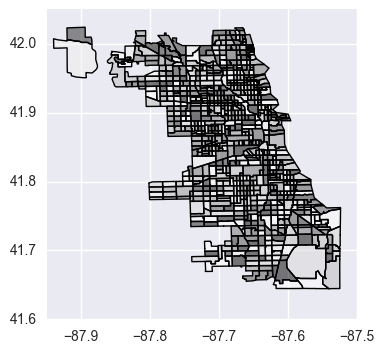

In [75]:
print "First, I will use geopandas to import a shape file of Chicago census tracts."
chicago = gpd.read_file("/Users/mkrupoff/Desktop/metrics_proj_2/census_tracts/census_tracts.shp")
print chicago.crs
chicago.plot()
chicago.head()


First, I will show if a simple visual display of crimes can give us an idea of where they are clustered. Since the dataset is very large, I will only use 5000 observations for display purposes here. Sample() takes a random sub sample of n observations in the full sample, in this case n=5000. Mplleaflet plots a basemap from open street map.


 Despite using only 5000 observations it is still difficult to see any spatial patterns

print "Mplleaflet plots a basemap from open street map. Despite using only 5000 observations it is still difficult to see any spatial patterns"




In [76]:

sample = crime.sample(5000)

f = plt.figure(figsize=(15, 8))
ax = f.gca()
plt.scatter(sample['Longitude'], sample['Latitude'])
chicago.plot(ax=ax)

mplleaflet.display(fig=f)

Despite using only 5000 observations it is still difficult to see any spatial patterns. A Kernel density map or a 'heatmap', is much more effective at highlighting areas with a high density of crime. It is a non-parametric way of estimating the density of features within a given 'bandwidth' or 'kernel'." 

"https://en.wikipedia.org/wiki/Kernel_density_estimation"

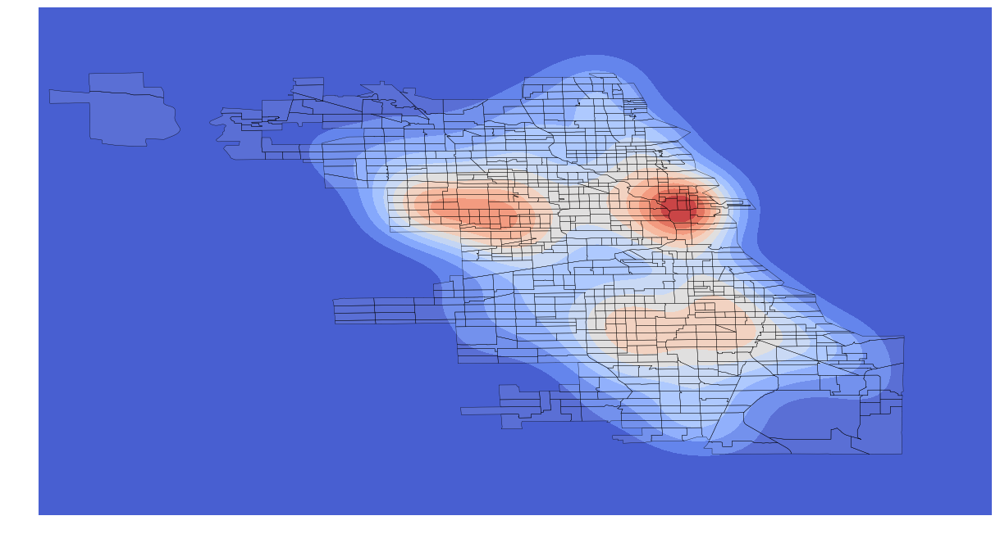

In [77]:

f = plt.figure(figsize=(15, 8))
ax = f.gca()

chicago.plot(ax=ax, alpha=0.1, linewidth=0.25, color='white')
sns.kdeplot(data=crimes_sample.apply(lambda srs: pd.Series({'x': srs.geometry.x, 'y': srs.geometry.y}), axis='columns'),shade=True,cmap="coolwarm",ax=ax,
            alpha=1)
ax.set_axis_off()




It appears that crimes are very concentrated near Downtown area, and the West Side of Chicago, with minor concentration in South-Central

## Chloropleth Maps


In order to get a better spatial distribution of crimes, I will make a series of chloropleth maps with different specifications. The first step is to convert the crimes dataframe into a geodataframe using shapely. Shapely takes the Longitude and Latitude columns to assign a geometry to this dataframe to be used in spatial analysis

In [79]:
crimes=gpd.GeoDataFrame(crime, geometry=crime.apply(lambda srs: shapely.geometry.Point(srs['Longitude'], srs['Latitude']), axis='columns'))
crimes.crs={'init':'epsg:4326'}



To make a chloropleth map we first do a spatial join to determine how many crimes happen in each census tract. Spatial join merges based on spatial relationship. This will give make a new column in the crimes dataframe that will be the census tract that the crime took place in based on spatial location. 

In [80]:
def spatial_join(point,polygon):
    crime_communities=gpd.sjoin(point,polygon, how="inner", op="intersects")
    return crime_communities

crimes=spatial_join(crimes, chicago)

In [81]:
crimes.head()

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location,geometry,index_right,commarea,commarea_n,countyfp10,geoid10,name10,namelsad10,notes,statefp10,tractce10
0,10508593,HZ250410,05/03/2016 09:00:00 PM,042XX W MADISON ST,1811,NARCOTICS,POSS: CANNABIS 30GMS OR LESS,SIDEWALK,True,False,1115,11,28,26,18,1148220.0,1899677.0,2016,05/10/2016 03:56:50 PM,41.880658,-87.731212,"(41.880658176, -87.731212135)",POINT (-87.73121213500001 41.880658176),716,26,26.0,031,17031260600,2606,Census Tract 2606,None,17,260600
467,10509861,HZ251377,05/04/2016 01:00:00 PM,042XX W WILCOX ST,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,1115,11,28,26,08B,1148160.0,1898999.0,2016,05/11/2016 03:50:55 PM,41.878799,-87.731450,"(41.878798822, -87.731449911)",POINT (-87.731449911 41.878798822),716,26,26.0,031,17031260600,2606,Census Tract 2606,None,17,260600
568,10510080,HZ251552,05/04/2016 06:00:00 PM,042XX W MADISON ST,1811,NARCOTICS,POSS: CANNABIS 30GMS OR LESS,SIDEWALK,True,False,1115,11,28,26,18,1148220.0,1899677.0,2016,05/11/2016 03:50:55 PM,41.880658,-87.731212,"(41.880658176, -87.731212135)",POINT (-87.73121213500001 41.880658176),716,26,26.0,031,17031260600,2606,Census Tract 2606,None,17,260600
1220,10511527,HZ252588,05/05/2016 03:46:00 PM,001XX S KEELER AVE,2024,NARCOTICS,POSS: HEROIN(WHITE),STREET,True,False,1115,11,28,26,18,1148412.0,1899086.0,2016,05/12/2016 03:50:15 PM,41.879033,-87.730522,"(41.879032706, -87.730522364)",POINT (-87.730522364 41.879032706),716,26,26.0,031,17031260600,2606,Census Tract 2606,None,17,260600
1644,10512491,HZ253659,05/06/2016 01:30:00 PM,043XX W MADISON ST,0890,THEFT,FROM BUILDING,BARBERSHOP,False,False,1115,11,28,26,06,1147539.0,1899662.0,2016,05/13/2016 03:51:16 PM,41.880630,-87.733713,"(41.880630098, -87.733713116)",POINT (-87.733713116 41.880630098),716,26,26.0,031,17031260600,2606,Census Tract 2606,None,17,260600


Now we have the names of the census tracts that each crime took place in. Which census tracts have the most crime?

839100    3454
320100    2368
320400    1440
252202    1364
838700    1354
Name: tractce10, dtype: int64


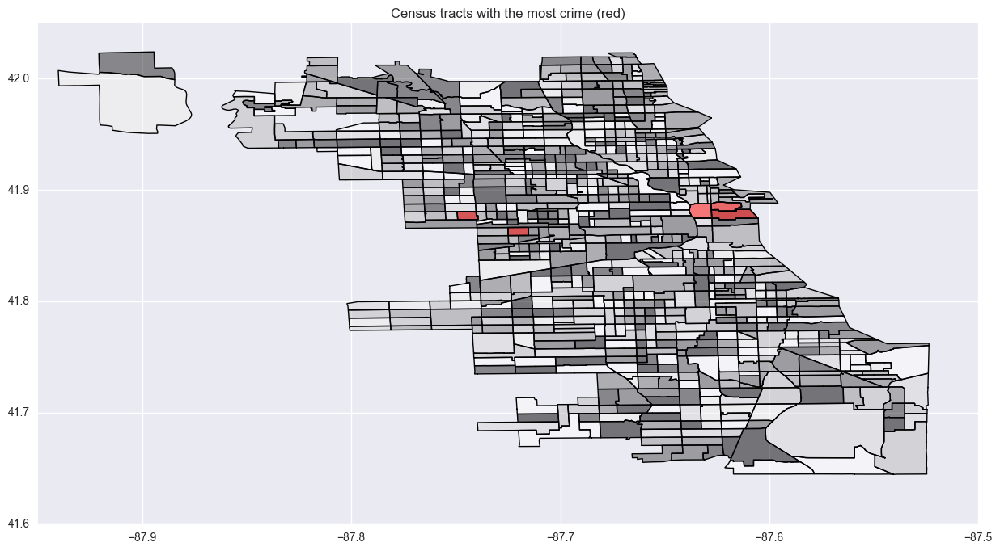

In [83]:
#Which census tracts have the most crime?
print crimes['tractce10'].value_counts().head(),

f=plt.figure(figsize=(15,8))
ax=f.gca()
chicago.plot( ax=ax)
plt.title('Census tracts with the most crime (red)')
for x in ['839100', '320100', '320400', '252202', '838700']:
    chicago[chicago['tractce10']==x].plot(color='r',ax=ax)

## Part 3: Making a Chloropleth Map

The next step is to count the number of crimes that took place in each census tract. For this we map the counts onto a new column in the Chicago geodataframe.

In [88]:
chicago["crimes"]=chicago['tractce10'].map(crimes['tractce10'].value_counts())
chicago['crimes']=chicago['crimes'].astype(float)
chicago.head()

,commarea,commarea_n,countyfp10,geoid10,geometry,name10,namelsad10,notes,statefp10,tractce10,crimes
0,44,44.0,031,17031842400,POLYGON ((-87.62404799998049 41.73021699998396...,8424,Census Tract 8424,None,17,842400,1064.0
1,59,59.0,031,17031840300,"POLYGON ((-87.6860799999848 41.82295600001154,...",8403,Census Tract 8403,None,17,840300,234.0
2,34,34.0,031,17031841100,"POLYGON ((-87.62934700001182 41.8527970000265,...",8411,Census Tract 8411,None,17,841100,425.0
3,31,31.0,031,17031841200,POLYGON ((-87.68813499997718 41.85569099999095...,8412,Census Tract 8412,None,17,841200,349.0
4,28,28.0,031,17031838200,"POLYGON ((-87.66781999997529 41.8741839999791,...",8382,Census Tract 8382,None,17,838200,392.0


The following function plots the chloropleth map. Here I set the number of classes to 5, and I use the fisher jenks color scheme which seeks to minimize the variance within each class, while maximizing the variance betweem classes.

In [89]:
def chloromap(df, col, str_title):
    f=plt.figure(figsize=(15,8))
    ax=f.gca()
    kw= dict(column=col,k=5, cmap='YlGn', alpha=1, legend=True, edgecolor='grey', linewidth=0.5)
    df.plot(scheme='fisher_jenks', ax=ax, **kw)
    plt.title(str_title)
    ax.set_axis_off() 

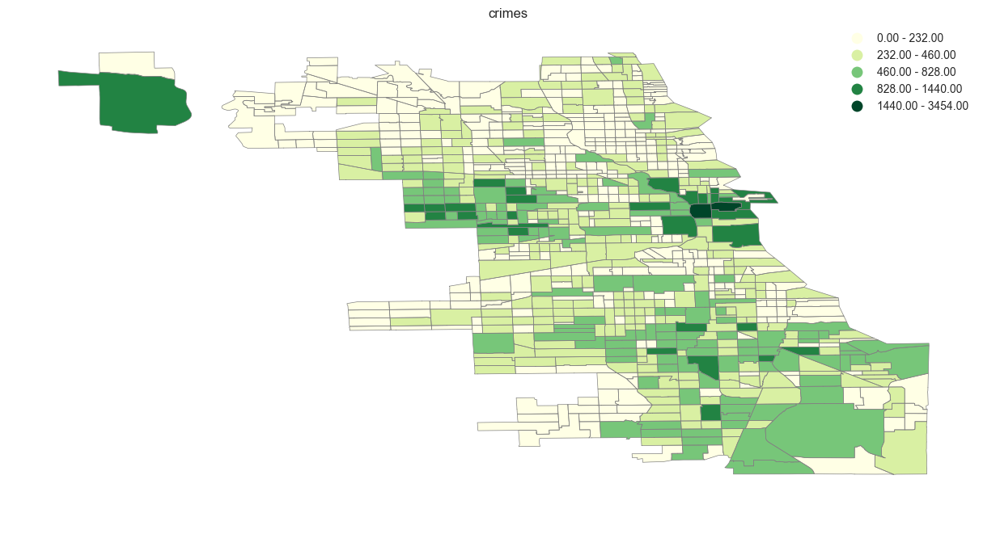

In [90]:
chloromap(chicago,'crimes', "crimes")

## Spatial Weighting

Larger census tracts will more likely have more crime incidences due to their size compared to smaller census tracts. Weighting by the size of each census tract will give us a better representation of the crime areas. New column will have the number of crimes per unit of area of each census tract.


In [91]:
#This creates a new column that is equal to the area of each tract.
chicago['area_tract']=chicago['geometry'].to_crs({'init': 'epsg:32617'}).area/10**6
#This gives us the density of crimes per unit of area of each tract. 
chicago['crimes_density'] = (chicago['crimes'].astype(float) / chicago['area_tract'])

tractce10
081201    5312.445381
081600    4353.341661
081500    3123.712914
839100    2892.853370
260800    2629.754950
Name: crimes_density, dtype: float64


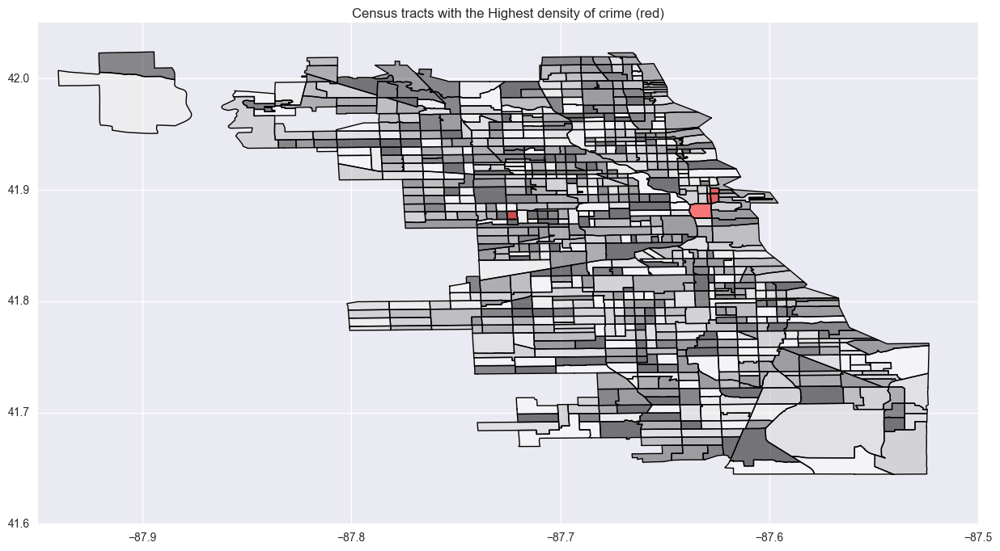

In [93]:
print chicago.groupby(chicago['tractce10']).crimes_density.sum().sort_values(ascending=False).head()

f=plt.figure(figsize=(15,8))
ax=f.gca()
chicago.plot( ax=ax)
plt.title('Census tracts with the Highest density of crime (red)')
for x in ['081201', '081600', '081500', '839100', '260800']:
    chicago[chicago['tractce10']==x].plot(color='r',ax=ax)

Let's see the comparison between the non-spatially weighted, and spatially weighted by the area of the census tracts

Comparison between the non-spatially weighted, and spatially weighted by the area of the census tracts


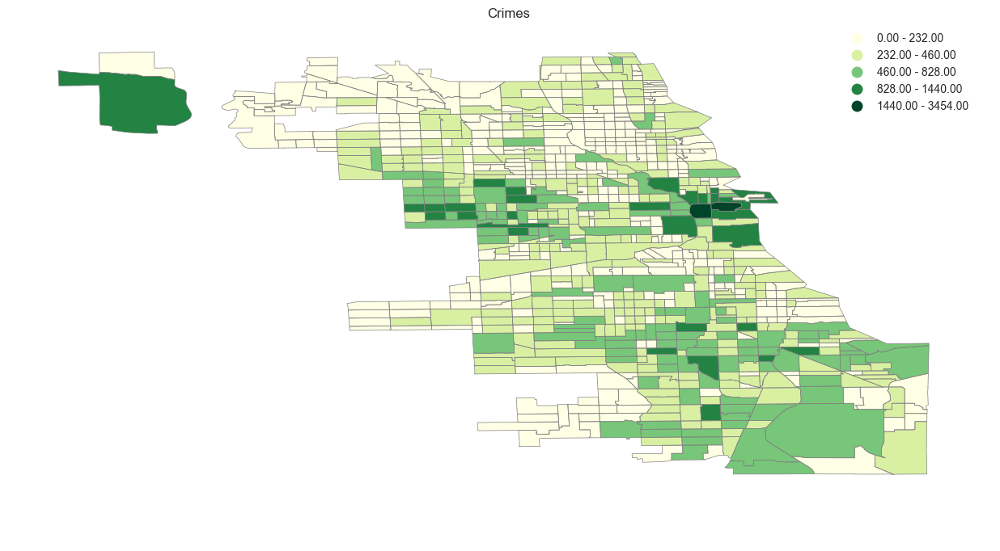

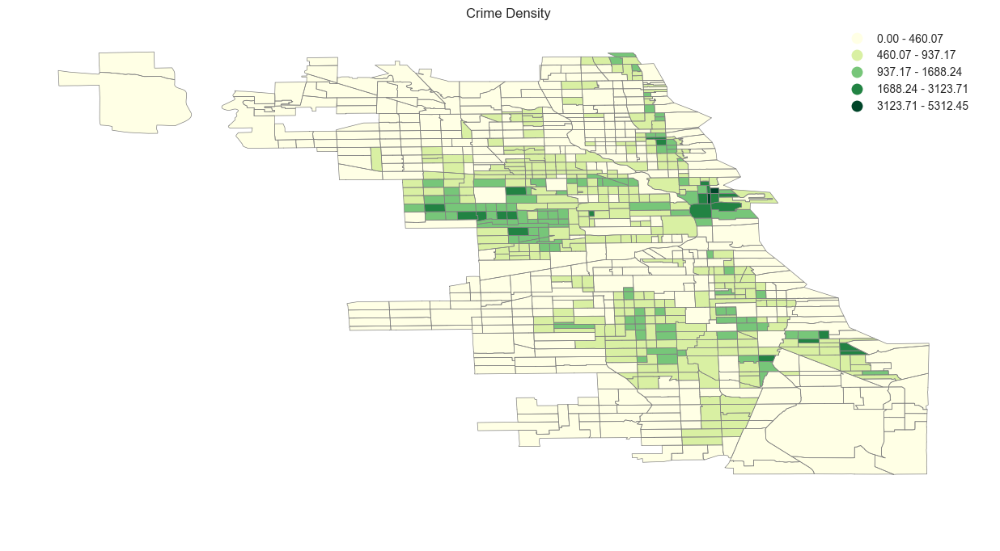

In [94]:
print "Comparison between the non-spatially weighted, and spatially weighted by the area of the census tracts"
chloromap(chicago, 'crimes', "Crimes"),
chloromap(chicago, 'crimes_density', "Crime Density")

## Spatial Autocorrelation

The spatially-weighted map gives us a much better representation of where the crime hotspots are. However it is likely the case that crime spills over to neighboring areas. It is therefore important to also take into account spatial autocorrelation. This is especially important for census tracts since the tract boundaires can be set in a somewhat arbitrary way. We do this using the pysal package

In [95]:
import pysal as ps

In [96]:
qW = ps.queen_from_shapefile("/Users/mkrupoff/Desktop/metrics_proj_2/census_tracts/census_tracts.shp")
#This gives the weight 'queen contiguity' or lists all census tracts that are adjacent to each census tract.

In [86]:
#Community area 4 is surrounded by areas 1, 3, 6, 7
qW[4]

{87: 1.0, 88: 1.0, 89: 1.0, 95: 1.0, 756: 1.0, 757: 1.0}

The following map illustrates the spatial neighborhoods. Each branch is to a centroid of the neighboring census tracts.

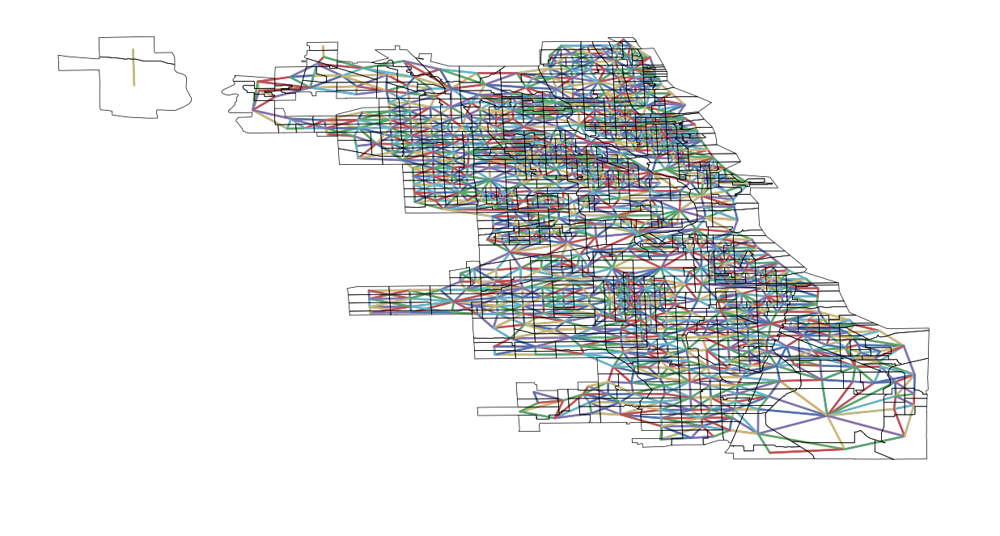

In [97]:
f = plt.figure(figsize=(15, 8))
ax = f.gca()

for i, (k, neighbors) in enumerate(qW.neighbors.items()):
    origin = chicago.geometry.iloc[i].centroid
    for nabe_i in neighbors:
        nabe_centroid = chicago.geometry.iloc[nabe_i].centroid
        plt.plot([origin.x, nabe_centroid.x], [origin.y, nabe_centroid.y], '-')

chicago.plot(ax=ax, linewidth=0.5, facecolor='white')

ax.set_axis_off()

Next I make the spatial lags that will give us the crime adjusted for spatial autocorrelation

In [102]:
#Creating spatial lags

crime_spatial_lags = ps.lag_spatial(qW, chicago['crimes_density'].astype(float))
spatial_lag_classes = ps.Fisher_Jenks(crime_spatial_lags, k=5)



In [103]:
spatial_lag_classes

                  Fisher_Jenks                 
 
  Lower              Upper                Count
            x[i] <=  2169.946               201
 2169.946 < x[i] <=  4131.342               280
 4131.342 < x[i] <=  6717.763               226
 6717.763 < x[i] <= 11816.570                82
11816.570 < x[i] <= 21508.151                12

In [104]:
spatial_lag_classes.yb


array([1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 3, 2, 1, 1, 1, 2, 2, 2, 1, 1, 3, 2, 1,
       1, 2, 0, 1, 0, 0, 0, 1, 0, 2, 3, 3, 3, 3, 3, 2, 0, 1, 1, 0, 2, 0, 0,
       1, 1, 2, 2, 2, 1, 0, 0, 1, 1, 1, 1, 1, 1, 3, 2, 2, 0, 1, 1, 2, 2, 2,
       1, 1, 2, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 2, 2, 2, 4,
       2, 0, 0, 3, 3, 4, 4, 1, 2, 2, 0, 4, 4, 1, 2, 2, 3, 1, 2, 1, 2, 1, 1,
       1, 1, 1, 2, 1, 3, 3, 2, 2, 1, 3, 0, 0, 0, 0, 0, 3, 3, 2, 1, 0, 1, 2,
       0, 3, 3, 1, 0, 1, 1, 1, 2, 2, 0, 2, 1, 2, 1, 2, 0, 0, 3, 3, 3, 2, 2,
       2, 2, 3, 2, 2, 1, 1, 1, 0, 0, 0, 1, 0, 1, 2, 2, 1, 2, 2, 0, 1, 1, 3,
       1, 1, 1, 2, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 3, 2, 1, 1, 1, 0, 1,
       1, 2, 1, 3, 0, 0, 1, 1, 0, 0, 3, 2, 1, 0, 2, 1, 1, 1, 1, 2, 0, 1, 4,
       1, 0, 3, 0, 0, 1, 1, 1, 1, 1, 3, 1, 1, 1, 2, 2, 2, 1, 0, 0, 0, 0, 1,
       1, 2, 0, 1, 2, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 2, 1, 2, 2, 2, 3,
       3, 3, 3, 3, 2, 2, 3, 2, 1, 2, 2, 1, 2, 3, 2, 1, 2, 1, 1, 0, 2, 3, 2,
       2, 3,

Comparison between crimes, crimes with spatial weights, and crimes with spatial weights corrected for spatial autocorrelation 


(None,)

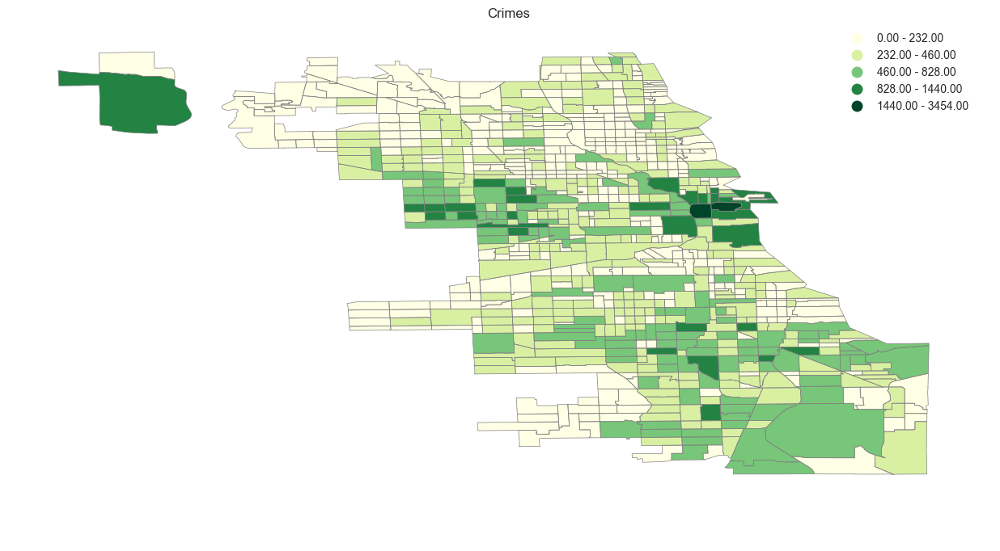

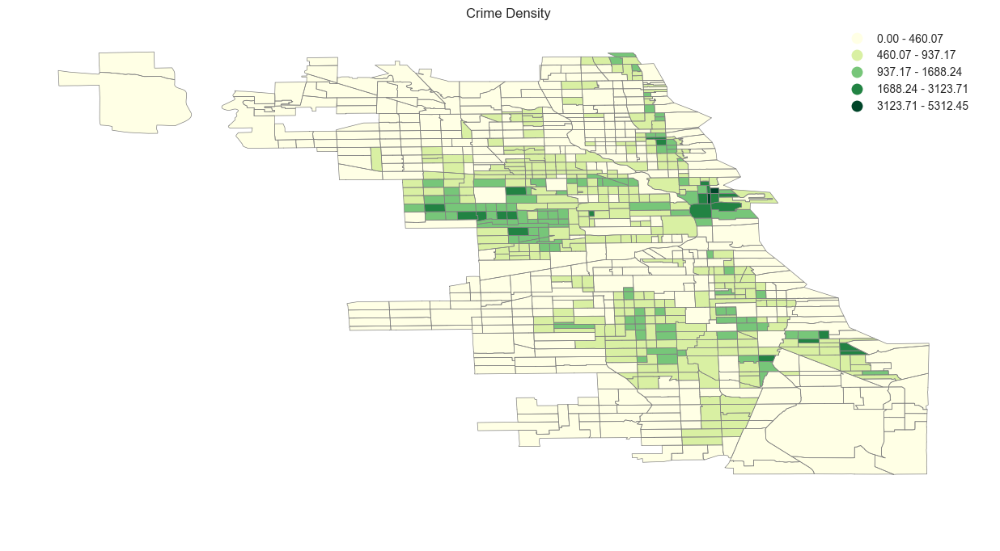

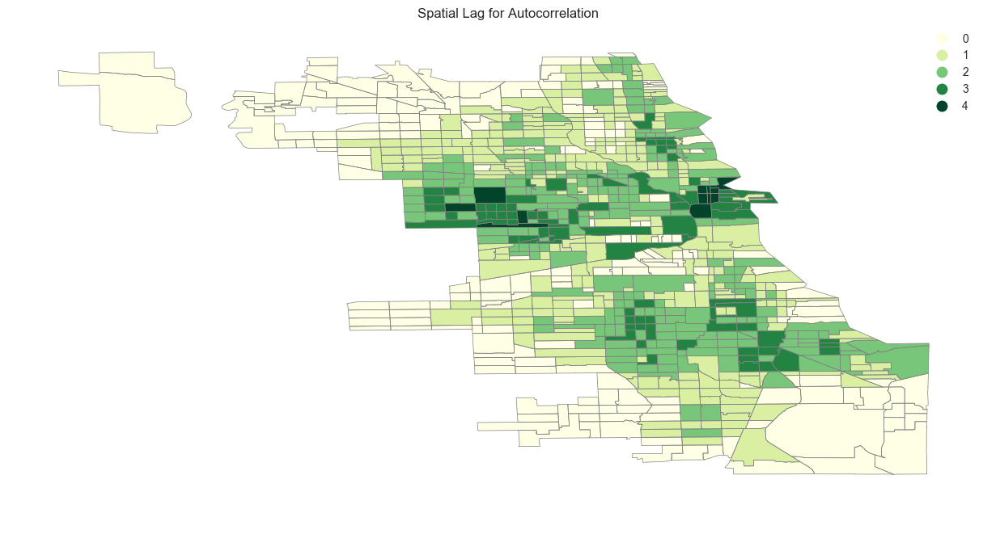

In [105]:
print "Comparison between crimes, crimes with spatial weights, and crimes with spatial weights corrected for spatial autocorrelation "
chloromap(chicago, 'crimes', "Crimes"),
chloromap(chicago, 'crimes_density', "Crime Density"),

f = plt.figure(figsize=(15, 8))
ax = f.gca()

kw = dict(column='spatial_class', k=5, cmap='YlGn', alpha=1, legend=True, edgecolor='gray', linewidth=0.5, 
          categorical=True)
chicago.assign(spatial_class=spatial_lag_classes.yb).plot(ax=ax, **kw)
plt.title("Spatial Lag for Autocorrelation")
ax.set_axis_off(),


There seems to be a quite a bit of spatial autocorrelation going on, with class 4 being very crime-prone areas. The Moran's I spatial autocorrelation measure  shows us how likely it is that the spatial relationship is completely random.

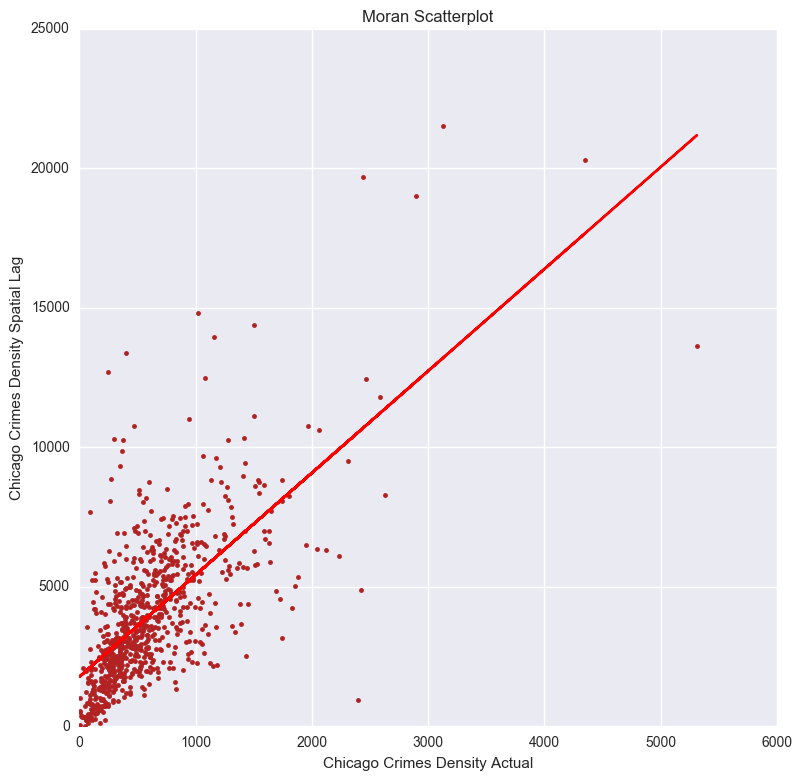

0.562990919034 0.001
--
P-value indicates that there is less than a 0.1% chance that this spatial relationship is completely random


In [107]:
f, ax = plt.subplots(1, figsize=(9, 9))
plt.plot(chicago['crimes_density'], crime_spatial_lags, '.', color='firebrick')

# Calculate and plot a line of best fit.
b,a = np.polyfit(chicago['crimes_density'], crime_spatial_lags, 1)
plt.plot(chicago['crimes_density'], a + b*chicago['crimes_density'], 'r')

plt.title('Moran Scatterplot')
plt.ylabel('Chicago Crimes Density Spatial Lag')
plt.xlabel('Chicago Crimes Density Actual')

plt.show()
moran = ps.Moran(chicago['crimes_density'].values, qW)
print moran.I, moran.p_sim
print "--"
print "P-value indicates that there is less than a 0.1% chance that this spatial relationship is completely random"

## Part 3  Spatial Clustering

We will now like to segment our sample to not only look at raw crimes, but also different types of crimes, and how they cluster in space. I will run K-means to predict the areas where prevalent crimes are clustered. 

To get a picture of crime heterogeneity, I split the full sample of crimes into subsamples depending on the Primary Type of crime.



In [109]:
print crimes['Primary Type'].value_counts()
print "Thefts is the most common, followed by Battery, Criminal Damage, and Assault."

THEFT                                58157
BATTERY                              48561
CRIMINAL DAMAGE                      30122
ASSAULT                              18024
OTHER OFFENSE                        15858
BURGLARY                             13585
DECEPTIVE PRACTICE                   13467
ROBBERY                              11579
MOTOR VEHICLE THEFT                  10897
NARCOTICS                            10647
CRIMINAL TRESPASS                     6199
WEAPONS VIOLATION                     3395
OFFENSE INVOLVING CHILDREN            1902
PUBLIC PEACE VIOLATION                1575
CRIM SEXUAL ASSAULT                   1260
INTERFERENCE WITH PUBLIC OFFICER       926
PROSTITUTION                           780
SEX OFFENSE                            766
HOMICIDE                               750
ARSON                                  499
LIQUOR LAW VIOLATION                   210
KIDNAPPING                             190
GAMBLING                               188
STALKING   

In [111]:
#Making subsamples
thefts=crimes[crimes["Primary Type"]=='THEFT']
battery=crimes[crimes["Primary Type"]=='BATTERY']
assault=crimes[crimes['Primary Type']=='ASSAULT']
narcotics=crimes[crimes['Primary Type']=='NARCOTICS']
murder=crimes[crimes["Primary Type"]=='HOMICIDE']
sexual_assault=crimes[crimes['Primary Type']=='CRIM SEXUAL ASSAULT']

#Since assault and battery are very similar, I append them togather
assault_battery=assault.append(battery)


One problem with this is that assault and battery are both divided into simple and aggravted categories. Simple is only a misdemeanor, but aggravated is a felony. This makes the distinction very important. Therefore I make two new columns, one indicating if the crime is aggravated, and another that indicates if it is simple. 

In [112]:


assault_battery['Simple']=assault_battery['Description'].str.contains('SIMPLE')
assault_battery['Simple']=assault_battery['Simple'].map(lambda x: 1 if x==True else 0)
assault_battery['Aggravated']=assault_battery['Description'].str.contains('AGGRAVATED')
assault_battery['Aggravated']=assault_battery['Aggravated'].map(lambda x: 1 if x==True else 0)

simple_assault_battery=assault_battery[assault_battery['Simple']==1]
aggravated_assault_battery=assault_battery[assault_battery['Aggravated']==1]




assault_battery.head()

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location,geometry,index_right,commarea,commarea_n,countyfp10,geoid10,name10,namelsad10,notes,statefp10,tractce10,Simple,Aggravated
16847,10535800,HZ279755,05/25/2016 07:45:00 PM,043XX W ADAMS ST,0560,ASSAULT,SIMPLE,RESIDENTIAL YARD (FRONT/BACK),True,False,1115,11,28,26,08A,1147504.0,1898659.0,2016,06/01/2016 03:53:48 PM,41.877878,-87.733867,"(41.877878421, -87.733867359)",POINT (-87.733867359 41.877878421),716,26,26.0,031,17031260600,2606,Census Tract 2606,None,17,260600,1,0
23569,10397004,HZ132306,01/28/2016 07:14:00 PM,043XX W WILCOX ST,051A,ASSAULT,AGGRAVATED: HANDGUN,SIDEWALK,False,False,1115,11,28,26,04A,1147582.0,1898986.0,2016,02/04/2016 06:53:43 AM,41.878774,-87.733573,"(41.878774252, -87.733572569)",POINT (-87.733572569 41.878774252),716,26,26.0,031,17031260600,2606,Census Tract 2606,None,17,260600,0,1
39933,10385904,HZ122326,01/20/2016 05:10:00 PM,043XX W MONROE ST,0520,ASSAULT,AGGRAVATED:KNIFE/CUTTING INSTR,RESIDENCE,False,False,1115,11,28,26,04A,1147407.0,1899307.0,2016,01/27/2016 04:00:46 PM,41.879658,-87.734207,"(41.879658467, -87.734206913)",POINT (-87.73420691299999 41.879658467),716,26,26.0,031,17031260600,2606,Census Tract 2606,None,17,260600,0,1
41050,10388346,HZ124600,01/22/2016 01:20:00 PM,043XX W WILCOX ST,0560,ASSAULT,SIMPLE,RESIDENCE,False,True,1115,11,28,26,08A,1147432.0,1898982.0,2016,01/29/2016 03:52:43 PM,41.878766,-87.734123,"(41.87876615, -87.734123448)",POINT (-87.73412344799999 41.87876615),716,26,26.0,031,17031260600,2606,Census Tract 2606,None,17,260600,1,0
43878,10395550,HZ131470,01/25/2016 11:30:00 AM,042XX W JACKSON BLVD,0560,ASSAULT,SIMPLE,RESIDENCE,False,True,1115,11,28,26,08A,1148216.0,1898350.0,2016,02/01/2016 04:05:16 PM,41.877017,-87.731261,"(41.877016813, -87.731261005)",POINT (-87.73126100499999 41.877016813),716,26,26.0,031,17031260600,2606,Census Tract 2606,None,17,260600,1,0


Next I am interested in Heroin and Crack because they they arguably cause the most social damage compared to other narcotics.

In [113]:

narcotics['Heroin']=narcotics['Description'].str.contains('HEROIN')
narcotics['Crack']=narcotics['Description'].str.contains('CRACK')
narcotics['Heroin']=narcotics['Heroin'].map(lambda x: 1 if x==True else 0)
narcotics['Crack']=narcotics['Crack'].map(lambda x: 1 if x==True else 0)

crack=narcotics[narcotics['Crack']==1]
heroin=narcotics[narcotics['Heroin']==1]


/Users/mkrupoff/anaconda2/envs/econ/lib/python2.7/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app
/Users/mkrupoff/anaconda2/envs/econ/lib/python2.7/site-packages/ipykernel/__main__.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()
/Users/mkrupoff/anaconda2/envs/econ/lib/python2.7/site-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col

Finally I want to merge these all into the Chicago census tracts so we can map the densities of each type of crime. 

In [114]:
#Finally I want to merge these all into the Chicago census tracts so we can map the densities of each type of crime. 
chicago["thefts"]=chicago['tractce10'].map(thefts['tractce10'].value_counts()).fillna(0)
chicago['assault_battery']=chicago['tractce10'].map(assault_battery["tractce10"].value_counts()).fillna(0)
chicago["simple_assault_battery"]=chicago['tractce10'].map(simple_assault_battery['tractce10'].value_counts()).fillna(0)
chicago["aggravated_assault_battery"]=chicago['tractce10'].map(aggravated_assault_battery['tractce10'].value_counts()).fillna(0)
chicago["heroin"]=chicago['tractce10'].map(heroin['tractce10'].value_counts()).fillna(0)
chicago["crack"]=chicago['tractce10'].map(crack['tractce10'].value_counts()).fillna(0)
chicago["narcotics"]=chicago['tractce10'].map(narcotics['tractce10'].value_counts()).fillna(0)
chicago['murders']=chicago['tractce10'].map(murder['tractce10'].value_counts()).fillna(0)
chicago['sexual_assault']=chicago['tractce10'].map(sexual_assault['tractce10'].value_counts()).fillna(0)

In [115]:
chicago.head()

,commarea,commarea_n,countyfp10,geoid10,geometry,name10,namelsad10,notes,statefp10,tractce10,crimes,area_tract,crimes_density,thefts,assault_battery,simple_assault_battery,aggravated_assault_battery,heroin,crack,narcotics,murders,sexual_assault
0,44,44.0,031,17031842400,POLYGON ((-87.62404799998049 41.73021699998396...,8424,Census Tract 8424,None,17,842400,1064.0,1.981826,536.878517,334.0,252.0,184.0,52.0,6.0,3.0,30.0,4.0,3.0
1,59,59.0,031,17031840300,"POLYGON ((-87.6860799999848 41.82295600001154,...",8403,Census Tract 8403,None,17,840300,234.0,0.836874,279.612035,26.0,61.0,39.0,18.0,0.0,1.0,21.0,0.0,2.0
2,34,34.0,031,17031841100,"POLYGON ((-87.62934700001182 41.8527970000265,...",8411,Census Tract 8411,None,17,841100,425.0,1.150888,369.280152,137.0,76.0,55.0,20.0,0.0,1.0,4.0,1.0,0.0
3,31,31.0,031,17031841200,POLYGON ((-87.68813499997718 41.85569099999095...,8412,Census Tract 8412,None,17,841200,349.0,0.629654,554.272268,56.0,118.0,84.0,33.0,2.0,0.0,14.0,1.0,1.0
4,28,28.0,031,17031838200,"POLYGON ((-87.66781999997529 41.8741839999791,...",8382,Census Tract 8382,None,17,838200,392.0,1.165402,336.364612,123.0,84.0,48.0,9.0,2.0,0.0,10.0,0.0,6.0


Next I get the densities of each type of crime. 

In [116]:
def densities(name, var):
    chicago[name]=chicago[var]/chicago['area_tract']
densities("thefts_density", 'thefts')
densities('assault_battery_densities', 'assault_battery')
densities('simple_assault_battery_density', 'simple_assault_battery')
densities('aggravated_assault_battery_density', 'aggravated_assault_battery')
densities('narcotics_density', 'narcotics')
densities('heroin_density', 'heroin')
densities('crack_density', 'crack')
densities('murders_density', 'murders')
densities('sexual_assaults_density', 'sexual_assault')

chicago.head()

,commarea,commarea_n,countyfp10,geoid10,geometry,name10,namelsad10,notes,statefp10,tractce10,crimes,area_tract,crimes_density,thefts,assault_battery,simple_assault_battery,aggravated_assault_battery,heroin,crack,narcotics,murders,sexual_assault,thefts_density,assault_battery_densities,simple_assault_battery_density,aggravated_assault_battery_density,narcotics_density,heroin_density,crack_density,murders_density,sexual_assaults_density
0,44,44.0,031,17031842400,POLYGON ((-87.62404799998049 41.73021699998396...,8424,Census Tract 8424,None,17,842400,1064.0,1.981826,536.878517,334.0,252.0,184.0,52.0,6.0,3.0,30.0,4.0,3.0,168.531414,127.155438,92.843653,26.238424,15.137552,3.027510,1.513755,2.018340,1.513755
1,59,59.0,031,17031840300,"POLYGON ((-87.6860799999848 41.82295600001154,...",8403,Census Tract 8403,None,17,840300,234.0,0.836874,279.612035,26.0,61.0,39.0,18.0,0.0,1.0,21.0,0.0,2.0,31.068004,72.890317,46.602006,21.508618,25.093388,0.000000,1.194923,0.000000,2.389846
2,34,34.0,031,17031841100,"POLYGON ((-87.62934700001182 41.8527970000265,...",8411,Census Tract 8411,None,17,841100,425.0,1.150888,369.280152,137.0,76.0,55.0,20.0,0.0,1.0,4.0,1.0,0.0,119.038543,66.035980,47.789196,17.377889,3.475578,0.000000,0.868894,0.868894,0.000000
3,31,31.0,031,17031841200,POLYGON ((-87.68813499997718 41.85569099999095...,8412,Census Tract 8412,None,17,841200,349.0,0.629654,554.272268,56.0,118.0,84.0,33.0,2.0,0.0,14.0,1.0,1.0,88.937670,187.404377,133.406506,52.409699,22.234418,3.176345,0.000000,1.588173,1.588173
4,28,28.0,031,17031838200,"POLYGON ((-87.66781999997529 41.8741839999791,...",8382,Census Tract 8382,None,17,838200,392.0,1.165402,336.364612,123.0,84.0,48.0,9.0,2.0,0.0,10.0,0.0,6.0,105.542978,72.078131,41.187504,7.722657,8.580730,1.716146,0.000000,0.000000,5.148438


(None,)

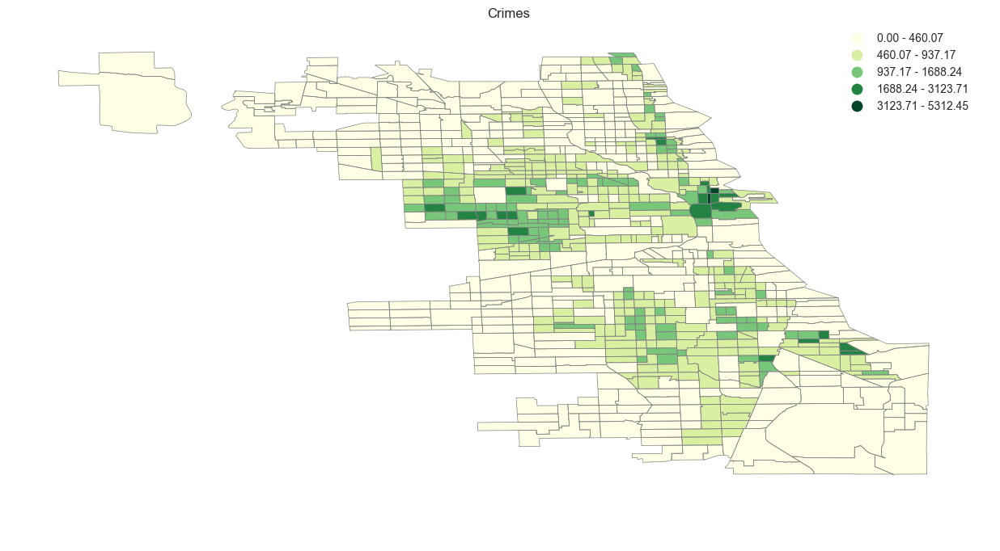

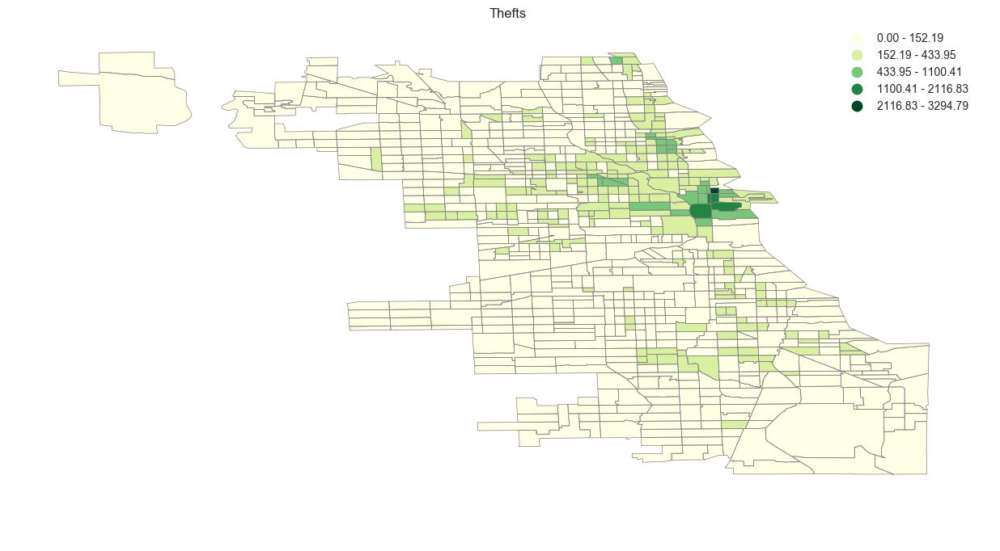

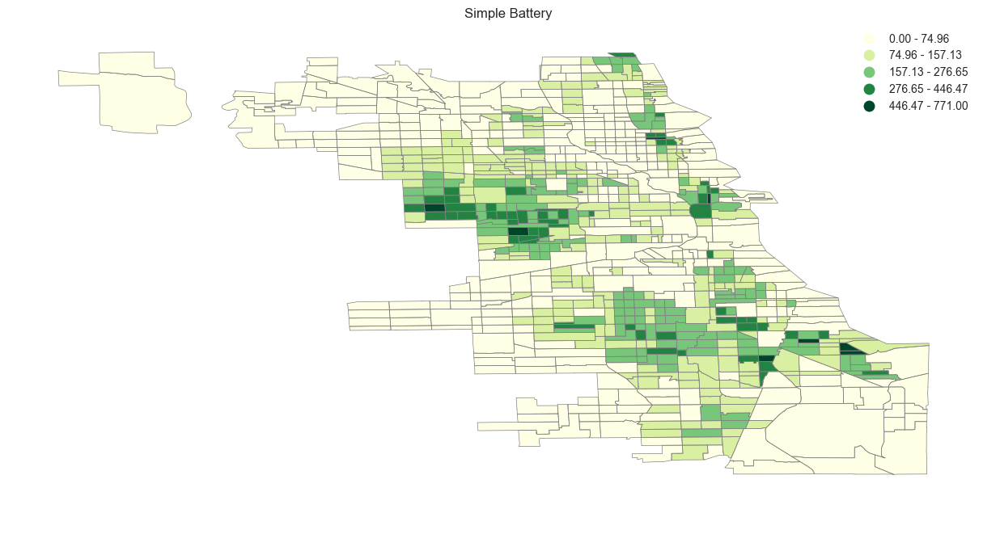

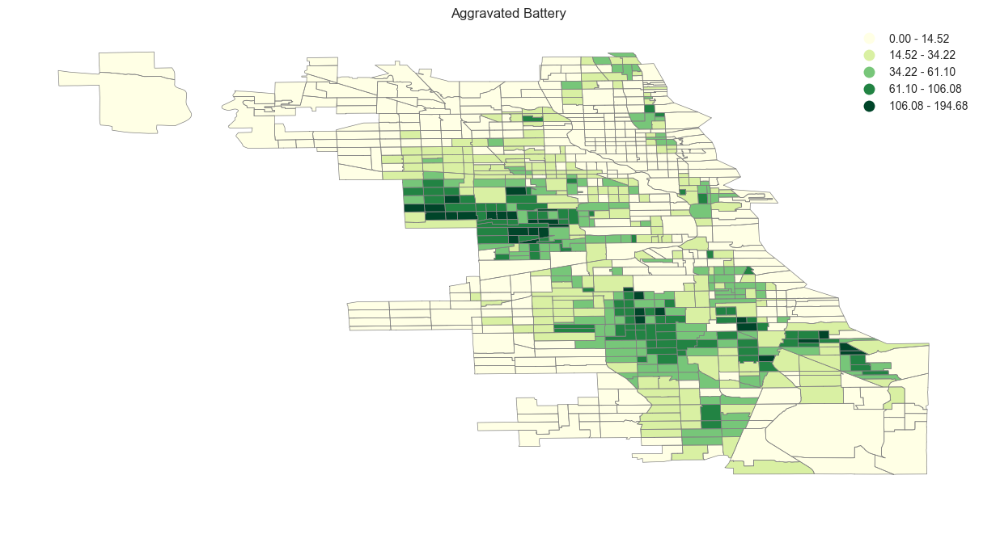

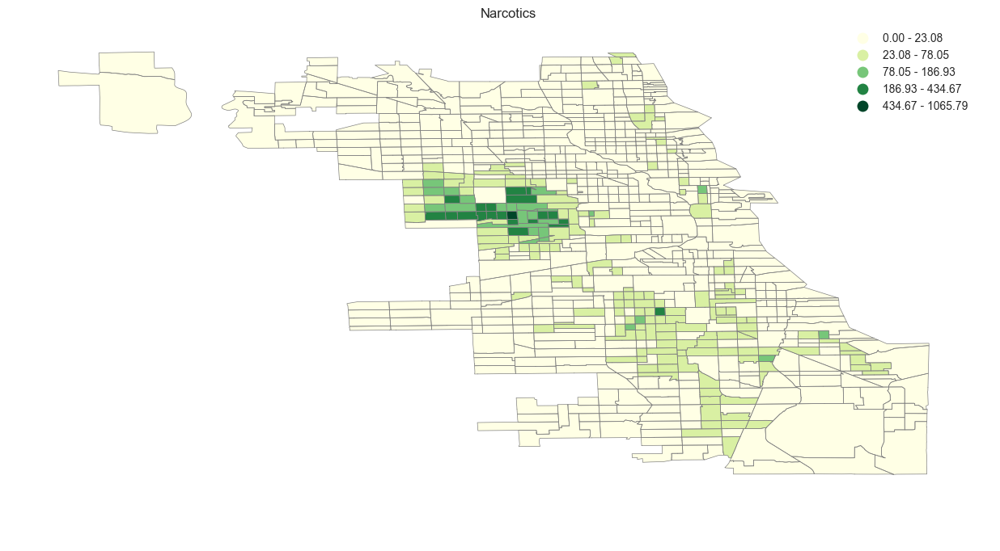

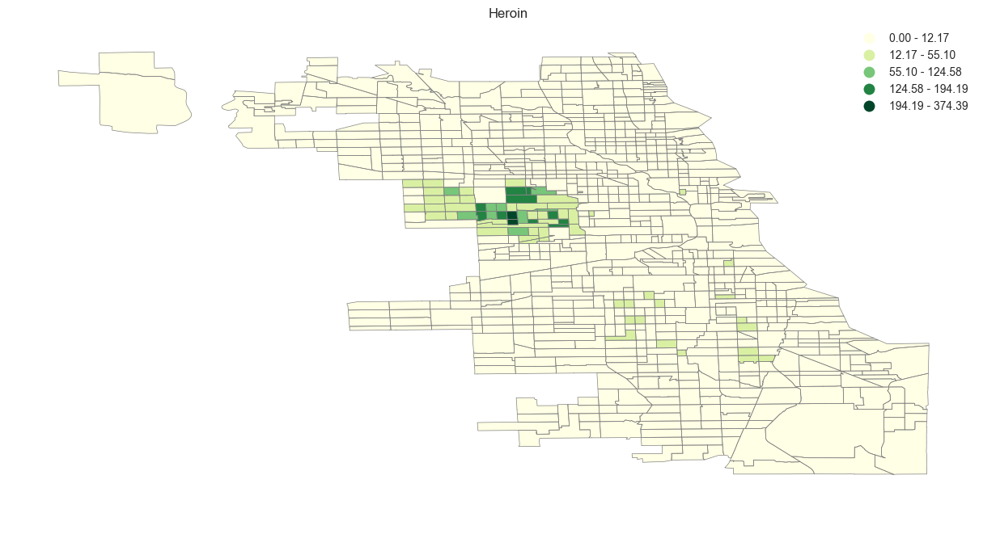

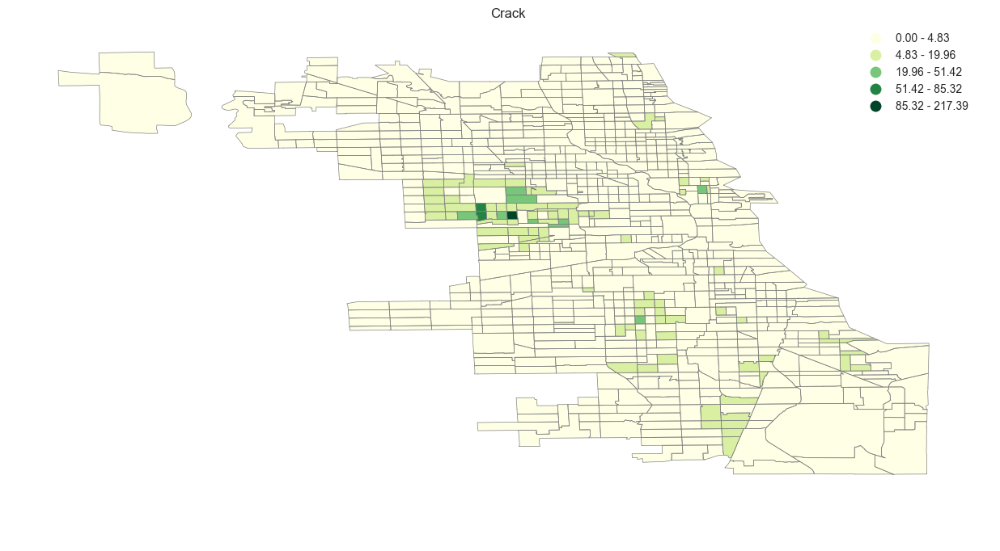

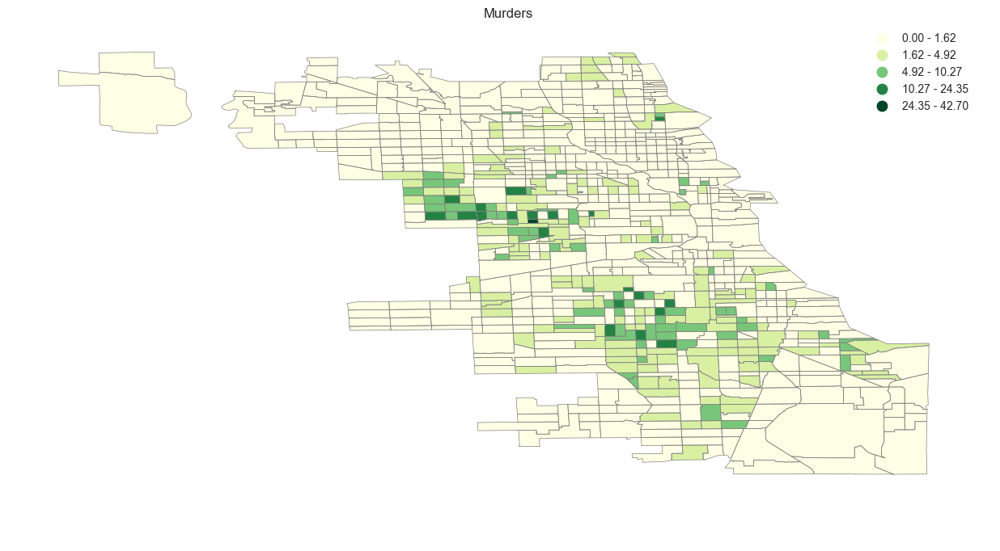

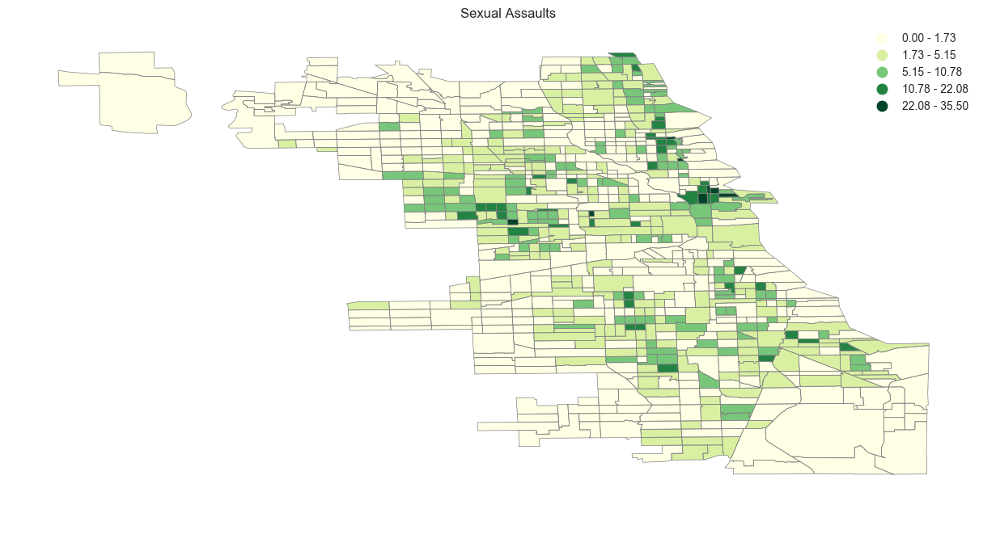

In [117]:
chloromap(chicago, 'crimes_density', 'Crimes'),
chloromap(chicago, 'thefts_density', 'Thefts'),
chloromap(chicago, 'simple_assault_battery_density', 'Simple Battery'),
chloromap(chicago, 'aggravated_assault_battery_density', 'Aggravated Battery'),
chloromap(chicago, 'narcotics_density', 'Narcotics'),
chloromap(chicago, 'heroin_density', 'Heroin'),
chloromap(chicago, 'crack_density', 'Crack'),


chloromap(chicago, 'murders_density', 'Murders'),
chloromap(chicago, 'sexual_assaults_density', 'Sexual Assaults'),








There is significant clustering of crimes in the west side which was not apparent if we looked at total crimes. When we looked at total crimes we saw that the majority of the crimes in the downtown cluster was crime. The other significant types happen in the West Side. Next we will jun sklean and see where the clustering is really happening. I will use total crimes, simple assault/battery, aggravated assault/battery, heroin, crack, murder, and sexual assault

In [138]:
chicago_crimes = chicago[['crimes_density',  'simple_assault_battery_density', 'aggravated_assault_battery_density', 'heroin_density', 'crack_density', 'murders_density', 'sexual_assaults_density']]


In [139]:
import sklearn.cluster
import sklearn.preprocessing
from sklearn.preprocessing import scale



In [140]:
clf = sklearn.cluster.KMeans(n_clusters=3)
X = sklearn.preprocessing.scale(chicago_crimes.values)
classes = clf.fit(X)
print clf.labels_

[0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 2 0 2 2 2 2 0 2 0 0 0 0 0 0 0 0 2 2 1 2 0
 2 2 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 2 1 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 2 0 0 0 0 0 2 0 0 0 0 0 0 0
 0 2 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 2 0 0 0 0 0
 0 2 0 2 0 0 0 0 2 2 0 0 0 2 2 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 2 0 2 2
 0 0 2 0 2 0 0 0 2 0 0 0 0 0 0 2 2 0 0 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 2
 0 0 0 2 0 0 0 2 0 0 2 0 0 0 0 0 0 0 2 0 0 2 2 2 2 2 0 0 0 0 2 0 0 0 0 0 0
 0 2 2 0 0 0 0 0 0 0 0 0 0 0 0 2 2 2 0 2 2 2 2 2 2 0 2 0 2 0 0 2 0 0 0 0 0
 2 0 0 0 0 2 0 0 0 0 0 0 2 2 0 2 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 0 2 2 0
 0 0 0 0 0 0 2 0 0 2 0 2 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 2 0 0 0 2 2 0 2 2 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 2 2 2 0 0 0
 0 2 2 0 0 0 0 0 2 0 0 0 0 0 0 1 0 0 0 0 0 2 0 0 0 0 2 2 2 0 0 0 0 0 0 0 0
 0 2 2 2 2 0 2 2 0 2 2 1 0 0 0 0 2 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 0 2 0 2 2
 0 0 0 0 0 2 0 2 0 0 0 0 

In [141]:
classes


KMeans(copy_x=True, init='k-means++', max_iter=300, n_clusters=3, n_init=10,
    n_jobs=1, precompute_distances='auto', random_state=None, tol=0.0001,
    verbose=0)

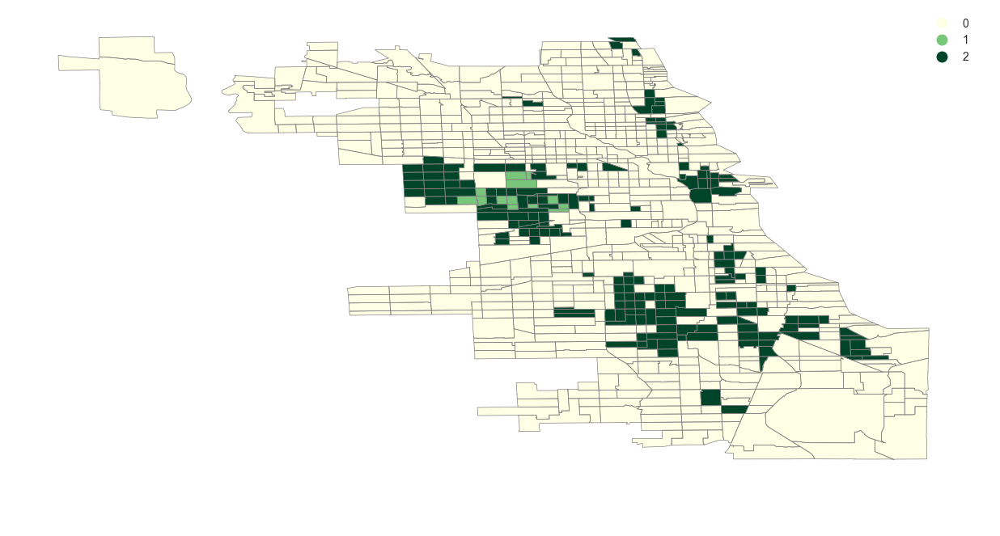

In [142]:
base_colors  =  ['r', 'g', 'b', 'y']
f = plt.figure(figsize=(15, 8))
ax = f.gca()

kw = dict(column='cluster', k=4, cmap='YlGn', alpha=1, legend=True, edgecolor='gray', linewidth=0.5, categorical=True)
chicago.assign(cluster=classes.labels_).plot(ax=ax, **kw)
ax.set_axis_off()

In [143]:
chicago_crimes.assign(cluster=classes.labels_).groupby('cluster').mean()



,crimes_density,simple_assault_battery_density,aggravated_assault_battery_density,heroin_density,crack_density,murders_density,sexual_assaults_density
cluster,,,,,,,
0,400.053184,72.951764,16.747243,1.213135,0.624636,0.758711,1.807849
1,1633.381695,321.911191,115.985729,192.501429,51.957888,13.855046,10.623688
2,1180.011913,264.758324,70.290250,12.709800,4.496529,4.148084,7.541329


Here we see that in cluster 0, there is relatively low crime. Cluster 1 has a very large amount of crime clustering with simple and aggravated assault and battery,narcotics, murder, and sexual assault. Cluster 2 is still high, but mostly consists of simple battery/assault.

## Conclusion

In this project I wanted to predict high crime rate areas of Chicago. I used geopandas, and shapely, along with sklearn to perform different techniques that each have their own strengths and weaknesses. First, a visual analysis of point distribution proved to be useless because of the shear amount of observations in the dataset. Next I used a kernel density estimator, or 'heat map', to plot the hot spots. This is useful to bring to attention certain areas of interest, but for the context of an inner-city, a smooth kernel density distribution does not capture too many details that we need. 

Next I use a series of chloropleth maps using Chicago census tracts. The simple chloropleth gives useful information as to the most crime-prone areas, but it does not take into account key spatial aspects and relations central to spatial analysis. One in particular is spatial weights. Areas could have more crime simply because they are larger. I thus control for this by looking at the density of crimes instead of raw count. This gives us a much better representation of high-crime areas. I further also adjust for spatial autocorrelation by using shapely, and queen contingency spatial relationships. This adjusts and classifies the census tracts by adjusting for the crimes in neighboring census tracts. 

Finally, I use spatial clustering to see where the different types of crimes are clustered. I find from chloropleth maps of the different crime categories that most crimes are clustered in West-side Chicago, with the exception of thefts which are clustered near downtown area. After importing sklearn and running clustering analysis, I am left with a map that indicates which areas where crime is highly clustered. For instance, there are 12 census tracts that have very high crime rates with each type. Other areas have high crime rates, but they mostly consist of beatings/assaults of the simple category as opposed to aggravated, as well as an elevated number of heroine incidences. 

This study indicates that the Westside of Chicago has very high crime rates. It is an example of how machine learning and spatial analysis can help policymakers either target social welfare funds to problem census tracts.